# بسم الله الرحمن الرحيم

# ٍPredict Smoking Status Using Bio-Signals

# Problem Statement

- Smoking remains a significant contributor to various health complications and is responsible for preventable illnesses and millions of deaths globally, with projections indicating a surge to 10 million smoking-related deaths by 2030. Despite concerted efforts, the complexity of factors influencing smoking cessation has hindered high success rates in quitting.

## Required Libraries:

In [1]:
import random
import itertools
import numpy as np
import pandas as pd
import seaborn as sns
from scipy import stats
from scipy.stats import zscore
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
from sklearn.preprocessing import MinMaxScaler, StandardScaler
from sklearn.ensemble import BaggingClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.preprocessing import PolynomialFeatures
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix

## Data Analysis:

### Data Loading

In [2]:
import random
import pandas as pd 
import numpy as np

id_1 = 7370
id_2 = 7524
id_3 = 0 

random_seed = id_1 + id_2 + id_3
random.seed(random_seed)

data_path = "data.csv"
output_path = "your_data.csv"

all_data = pd.read_csv(data_path) 
all_data.head()

,id,age,height(cm),weight(kg),waist(cm),eyesight(left),eyesight(right),hearing(left),hearing(right),systolic,...,HDL,LDL,hemoglobin,Urine protein,serum creatinine,AST,ALT,Gtp,dental caries,smoking
0,0,55,165,60,81.0,0.5,0.6,1,1,135,...,40,75,16.5,1,1.0,22,25,27,0,1
1,1,70,165,65,89.0,0.6,0.7,2,2,146,...,57,126,16.2,1,1.1,27,23,37,1,0
2,2,20,170,75,81.0,0.4,0.5,1,1,118,...,45,93,17.4,1,0.8,27,31,53,0,1
3,3,35,180,95,105.0,1.5,1.2,1,1,131,...,38,102,15.9,1,1.0,20,27,30,1,0
4,4,30,165,60,80.5,1.5,1.0,1,1,121,...,44,93,15.4,1,0.8,19,13,17,0,1


In [22]:
all_columns = all_data.columns.tolist()

target_column = 'smoking'  

all_columns.remove(target_column)
all_columns.remove('id')

features_indices = random.sample(range(len(all_columns)), 10)
features = [
    "hemoglobin",
    "height(cm)",
    "weight(kg)",
    "triglyceride",
    "Gtp",
    "serum creatinine",
    "HDL",
    "waist(cm)",
    "age",
    "ALT"
]
feature_indices = [all_data.columns.get_loc(feature) for feature in features]
features_indices = [0, 12, 10, 1, 15, 3, 13, 18, 4, 8]
selected_columns = [all_columns[i] for i in features_indices]
print("Features Numbers Selected Randomly are: ", features_indices)
print()
print("Selected Features are:", selected_columns)

Features Numbers Selected Randomly are:  [0, 12, 10, 1, 15, 3, 13, 18, 4, 8]

Selected Features are: ['age', 'triglyceride', 'fasting blood sugar', 'height(cm)', 'hemoglobin', 'waist(cm)', 'HDL', 'AST', 'eyesight(left)', 'systolic']


In [23]:
selected_columns = np.append(selected_columns, target_column)
data = all_data[selected_columns].copy()
data.to_csv(output_path)
# Show dimensions of loaded data to make sure that data are fully loaded
print("data shape:", data.shape)
data.head()

data shape: (159256, 11)


,age,triglyceride,fasting blood sugar,height(cm),hemoglobin,waist(cm),HDL,AST,eyesight(left),systolic,smoking
0,55,300,94,165,16.5,81.0,40,22,0.5,135,1
1,70,55,147,165,16.2,89.0,57,27,0.6,146,0
2,20,197,79,170,17.4,81.0,45,27,0.4,118,1
3,35,203,91,180,15.9,105.0,38,20,1.5,131,0
4,30,87,91,165,15.4,80.5,44,19,1.5,121,1


### Univariate Analysis

In [5]:
# Calculate mean, median, and standard deviation for each numeric feature
summary_statistics = data.describe()

# Print the summary statistics
print("Summary Statistics:")
print(summary_statistics)

Summary Statistics:
                 age   triglyceride  fasting blood sugar     height(cm)  \
count  159256.000000  159256.000000        159256.000000  159256.000000   
mean       44.306626     127.616046            98.352552     165.266929   
std        11.842286      66.188989            15.329740       8.818970   
min        20.000000       8.000000            46.000000     135.000000   
25%        40.000000      77.000000            90.000000     160.000000   
50%        40.000000     115.000000            96.000000     165.000000   
75%        55.000000     165.000000           103.000000     170.000000   
max        85.000000     766.000000           375.000000     190.000000   

          hemoglobin      waist(cm)            HDL            AST  \
count  159256.000000  159256.000000  159256.000000  159256.000000   
mean       14.796965      83.001990      55.852684      25.516853   
std         1.431213       8.957937      13.964141       9.464882   
min         4.900000      51

#### Check for nulls (Nan):

In [6]:
for column in data.columns:
    if column == "smoking":
        break
    null_count = data[column].isnull().sum()
    print(f"Number of null values in {column}: {null_count}")

Number of null values in age: 0
Number of null values in triglyceride: 0
Number of null values in fasting blood sugar: 0
Number of null values in height(cm): 0
Number of null values in hemoglobin: 0
Number of null values in waist(cm): 0
Number of null values in HDL: 0
Number of null values in AST: 0
Number of null values in eyesight(left): 0
Number of null values in systolic: 0


#### Check for categorical features to apply one hot encoding

In [7]:
data.dtypes  # we noticed that there is no features of type object (categorial data) for one hot encoding

age                      int64
triglyceride             int64
fasting blood sugar      int64
height(cm)               int64
hemoglobin             float64
waist(cm)              float64
HDL                      int64
AST                      int64
eyesight(left)         float64
systolic                 int64
smoking                  int64
dtype: object

In [8]:
data.nunique() # To combine sparse classes (but no categorical features found)

age                     18
triglyceride           392
fasting blood sugar    229
height(cm)              14
hemoglobin             134
waist(cm)              531
HDL                    108
AST                    140
eyesight(left)          20
systolic               112
smoking                  2
dtype: int64

#### Visualize Realtionship between each feature and target (smoking)

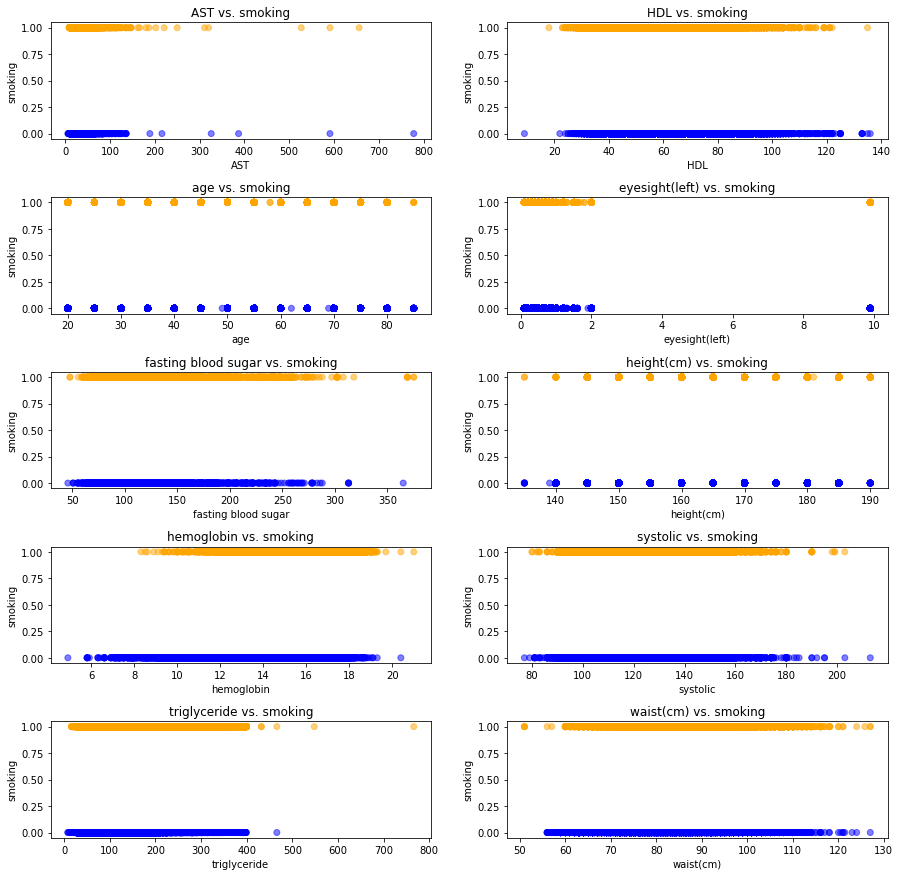

In [9]:
# Extract feature names from the DataFrame (excluding 'smoking')
features = data.columns.difference(['smoking']).tolist()[:10]  

# Create basic scatter plots to visualize relationships
fig, axes = plt.subplots(nrows=5, ncols=2, figsize=(15, 15))  # 5 rows and 2 columns for 10 features
fig.subplots_adjust(hspace=0.5)

for i, feature in enumerate(features):
    row, col = i // 2, i % 2
    # Add colors based on the 'smoking' label (0 or 1)
    colors = np.where(data['smoking'] == 1, 'orange', 'blue')
    axes[row, col].scatter(data[feature], data['smoking'], alpha=0.5, c=colors)
    axes[row, col].set_title(f'{feature} vs. smoking')
    axes[row, col].set_xlabel(feature)
    axes[row, col].set_ylabel('smoking')

# If there are extra subplots, remove them
for j in range(len(features), 10):
    fig.delaxes(axes.flatten()[j])

plt.show()

#### Identify Skewed features

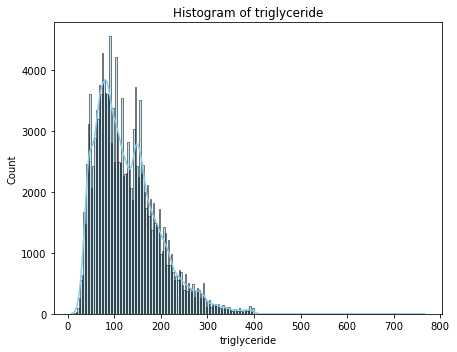

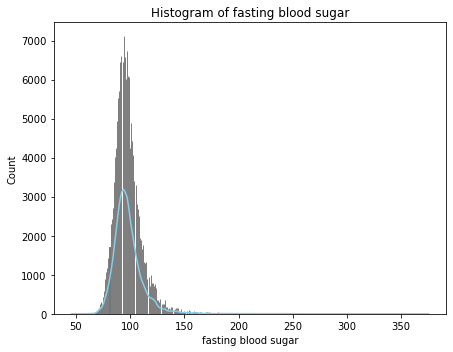

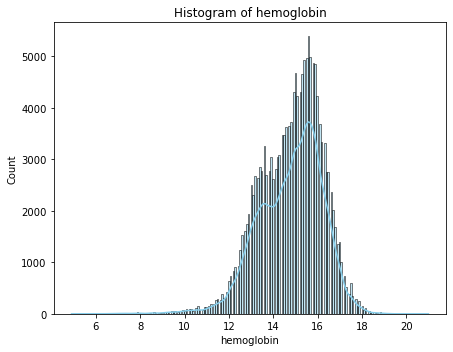

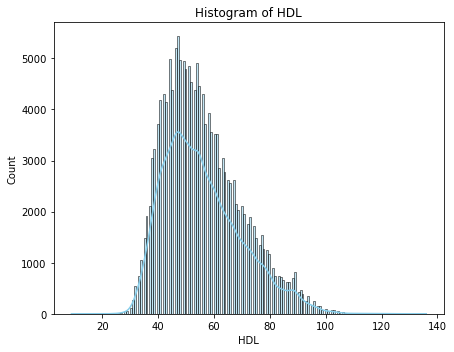

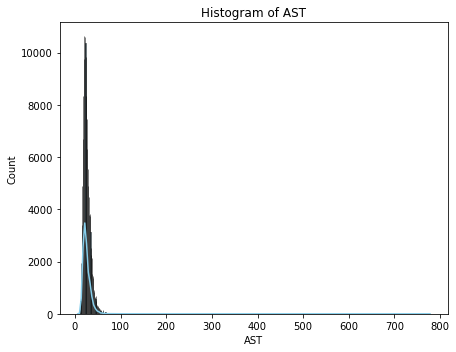

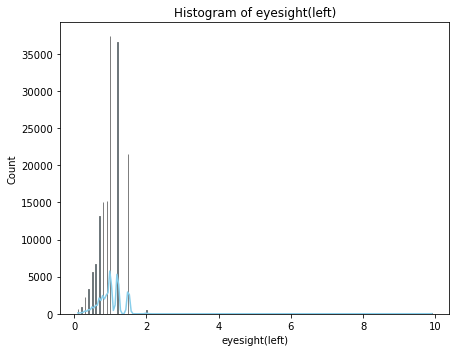

In [10]:
# Calculate skewness for all numeric features
numeric_features = data.select_dtypes(include=[np.number])
skewness = numeric_features.apply(lambda x: stats.skew(x))

# Assume threshold = 0.5
skew_threshold = 0.5

# Filter features with skewness above the threshold
skewed_features = skewness[abs(skewness) > skew_threshold]

# Create a histogram and boxplot for each skewed feature
for feature in skewed_features.index:
    plt.figure(figsize=(12, 5))
    
    plt.subplot(1, 2, 1)
    sns.histplot(data[feature], kde=True, color='skyblue', edgecolor='black', linewidth=0.5)
    plt.title(f'Histogram of {feature}')
    
    plt.tight_layout()
    plt.show()

#### Correlations of each deature with 'smoking'

In [11]:
# Extract features (X) and target variable (y)
X = data.drop(columns=['smoking'])
y = data['smoking']

# Calculate the correlation matrix between X (features) and y (target)
correlation_matrix = np.corrcoef(X, y, rowvar=False)

# Sort the correlations with the target variable
correlations_with_target = correlation_matrix[:-1, -1]

# Create a Pandas Series to associate feature names with their correlations
correlations_series = pd.Series(correlations_with_target, index=X.columns)

# Sort the correlations in descending order
correlations_sorted = correlations_series.abs().sort_values(ascending=False)

# Display the correlations
print("Sorted Correlations of each feature with smoking:")
print(correlations_sorted)

Sorted Correlations of each feature with smoking:
hemoglobin             0.450679
height(cm)             0.447111
triglyceride           0.331975
HDL                    0.271186
waist(cm)              0.262715
age                    0.206033
eyesight(left)         0.100420
fasting blood sugar    0.096534
AST                    0.059394
systolic               0.058642
dtype: float64


#### Visualization of distribution and boxplot of each feature

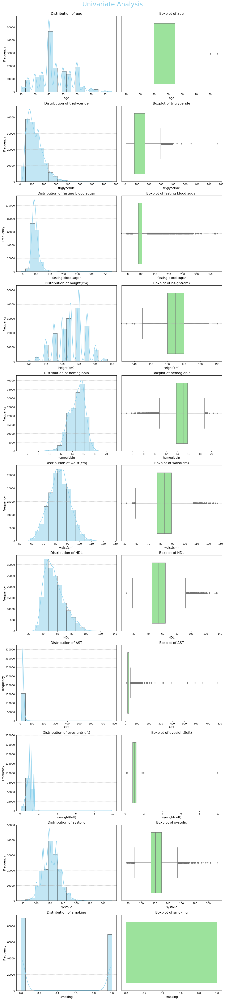

In [12]:
# Set a color palette for better visualization
sns.set_palette("pastel")

# Number of features
num_features = len(data.columns)

# Create subplots
fig, axes = plt.subplots(num_features, 2, figsize=(15, num_features * 6))

# Add a title to the overall figure
fig.suptitle("Univariate Analysis", fontsize=30, y = 1, color = 'skyblue')

# Visualize the distribution of each feature
for i, feature in enumerate(data.columns):
    # Distribution plot with KDE
    sns.histplot(data[feature], bins=20, kde=True, color='skyblue', edgecolor='black', linewidth=0.5, ax=axes[i, 0])
    axes[i, 0].set_title(f'Distribution of {feature}', fontsize=16)
    axes[i, 0].set_xlabel(feature, fontsize=14)
    axes[i, 0].set_ylabel('Frequency', fontsize=14)
    axes[i, 0].tick_params(labelsize=12)
    axes[i, 0].grid(axis='y', linestyle='--', alpha=0.7)

    # Box plot for identifying outliers
    sns.boxplot(x=data[feature], color='lightgreen', ax=axes[i, 1])
    axes[i, 1].set_title(f'Boxplot of {feature}', fontsize=16)
    axes[i, 1].set_xlabel(feature, fontsize=14)
    axes[i, 1].tick_params(labelsize=12)
    axes[i, 1].grid(axis='y', linestyle='--', alpha=0.7)

# Adjust layout to prevent overlapping
plt.tight_layout()

# Show the subplots
plt.show()

## Initial Data Cleaning:

## Outliers Detection:

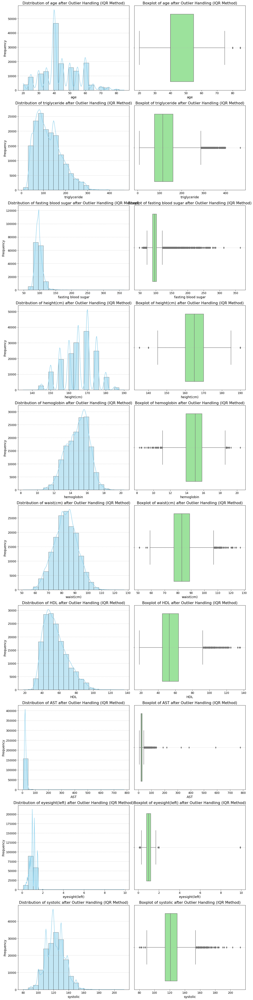

In [13]:
# Univariate Analysis - Outlier Detection and Handling (IQR Method)
for feature in data.columns[:-1]:  # Exclude the last column (smoking label)
    # Calculate the IQR for each feature
    Q1 = data[feature].quantile(0.25)
    Q3 = data[feature].quantile(0.75)
    IQR = Q3 - Q1

    # Define the upper and lower bounds for outliers
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR

     # Identify outliers in each class separately
    outliers_class_0 = (data[feature] < lower_bound) & (data['smoking'] == 0)
    outliers_class_1 = (data[feature] > upper_bound) & (data['smoking'] == 1)

    # Replace outliers with the median within each class
    data.loc[outliers_class_0, feature] = data.loc[data['smoking'] == 0, feature].median()
    data.loc[outliers_class_1, feature] = data.loc[data['smoking'] == 1, feature].median()

# Visualize the distribution of each feature after outlier handling using IQR method
fig, axes = plt.subplots(data.shape[1] - 1, 2, figsize=(15, (data.shape[1] - 1) * 6))

# Visualize the distribution of each feature after handling outliers
for i, feature in enumerate(data.columns[:-1]):
    # Distribution plot with KDE
    sns.histplot(data[feature], bins=20, kde=True, color='skyblue', edgecolor='black', linewidth=0.5, ax=axes[i, 0])
    axes[i, 0].set_title(f'Distribution of {feature} after Outlier Handling (IQR Method)', fontsize=16)
    axes[i, 0].set_xlabel(feature, fontsize=14)
    axes[i, 0].set_ylabel('Frequency', fontsize=14)
    axes[i, 0].tick_params(labelsize=12)
    axes[i, 0].grid(axis='y', linestyle='--', alpha=0.7)

    # Box plot for identifying outliers
    sns.boxplot(x=data[feature], color='lightgreen', ax=axes[i, 1])
    axes[i, 1].set_title(f'Boxplot of {feature} after Outlier Handling (IQR Method)', fontsize=16)
    axes[i, 1].set_xlabel(feature, fontsize=14)
    axes[i, 1].tick_params(labelsize=12)
    axes[i, 1].grid(axis='y', linestyle='--', alpha=0.7)

# Adjust layout to prevent overlapping
plt.tight_layout()

# Show the subplots
plt.show()

### Bivariate Analysis

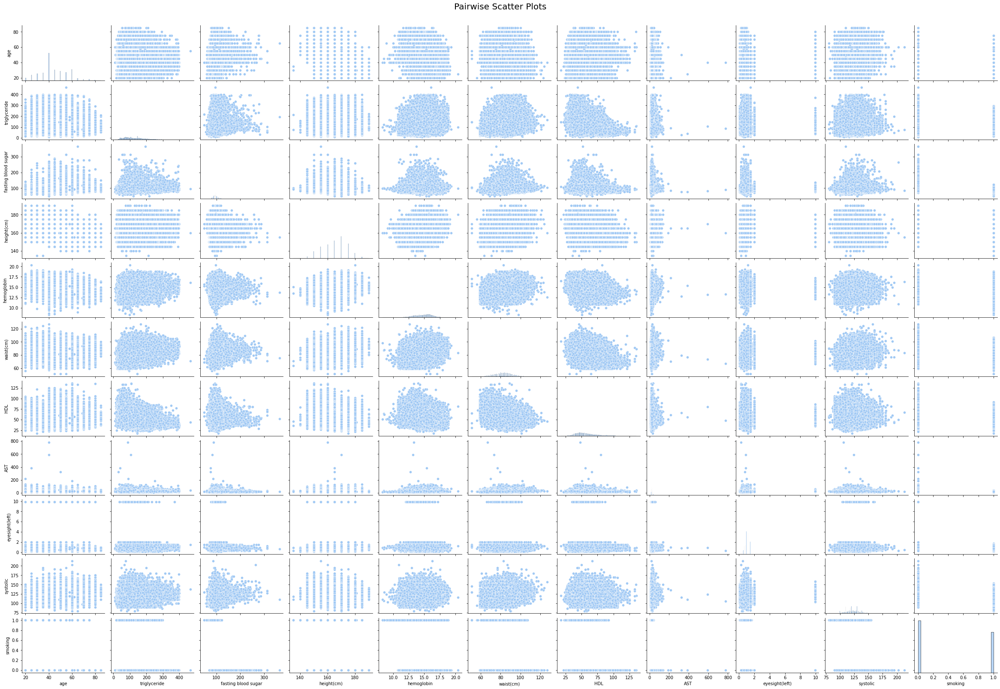

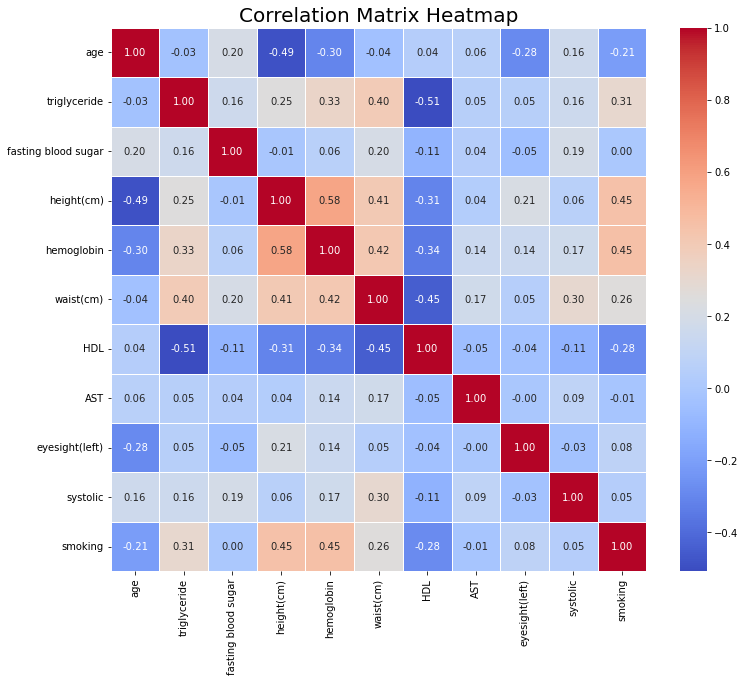

Correlation Coefficients with Target:
 smoking                1.000000
hemoglobin             0.453472
height(cm)             0.446379
triglyceride           0.307867
waist(cm)              0.256078
eyesight(left)         0.082497
systolic               0.045803
fasting blood sugar    0.002673
AST                   -0.014791
age                   -0.208206
HDL                   -0.282331
Name: smoking, dtype: float64


In [14]:
import seaborn as sns
import matplotlib.pyplot as plt

# Pairwise Scatter Plots
sns.pairplot(data, height=2, aspect=1.5)
plt.suptitle("Pairwise Scatter Plots", y=1.02, fontsize=20)
plt.show()

# Heatmap of Correlation Matrix
correlation_matrix = data.corr()
plt.figure(figsize=(12, 10))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f", linewidths=.5)
plt.title("Correlation Matrix Heatmap", fontsize=20)
plt.show()

# Correlation Coefficients
correlation_with_target = data.corr()[target_column].sort_values(ascending=False)
print("Correlation Coefficients with Target:\n", correlation_with_target)

### Multivariate Analysis

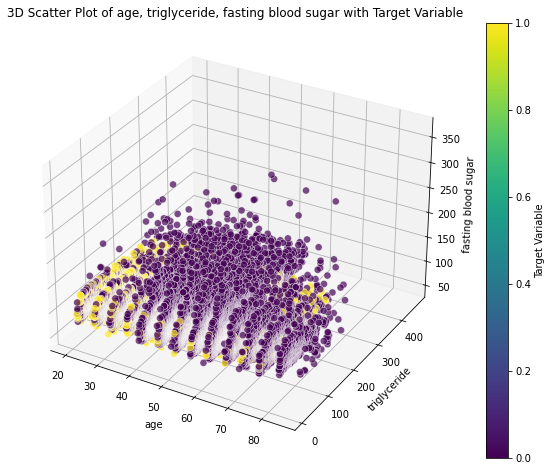

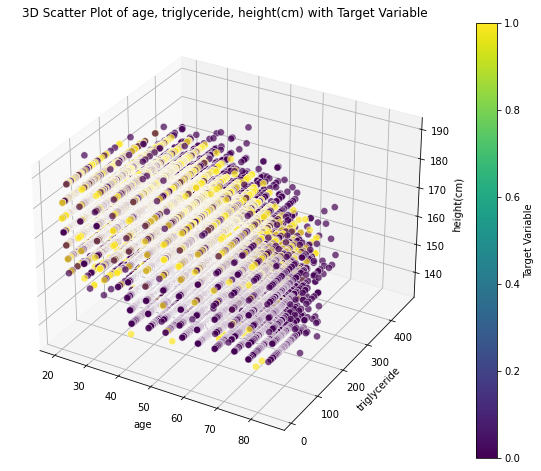

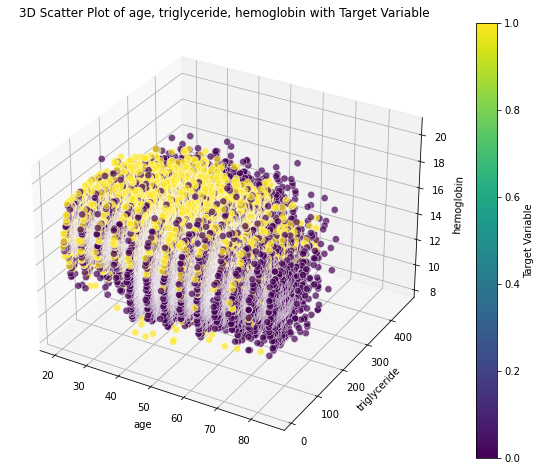

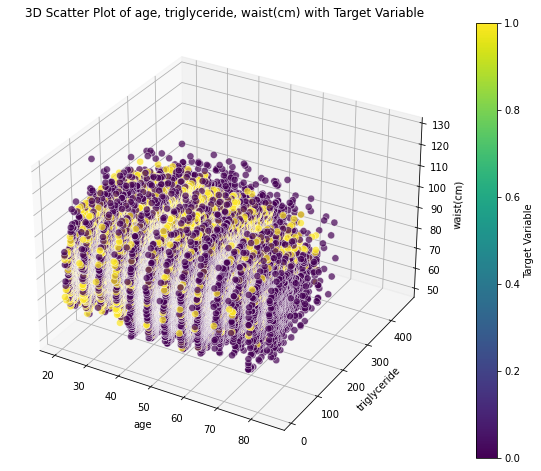

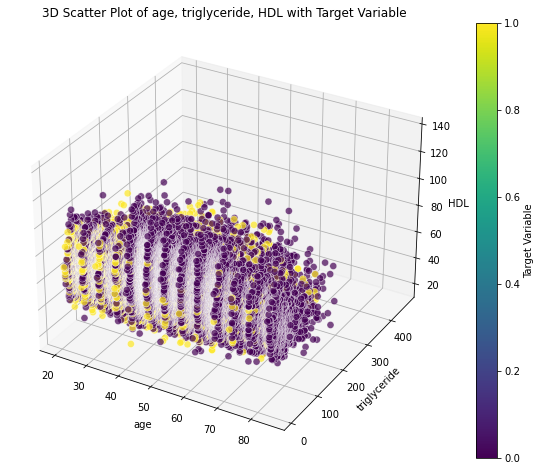

...

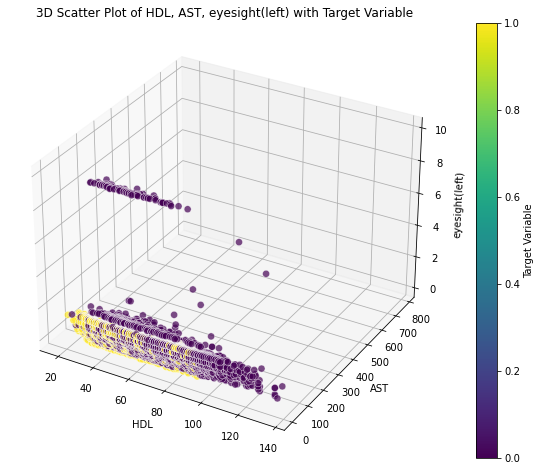

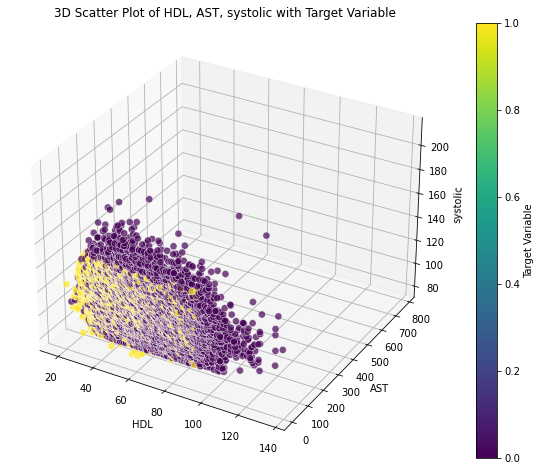

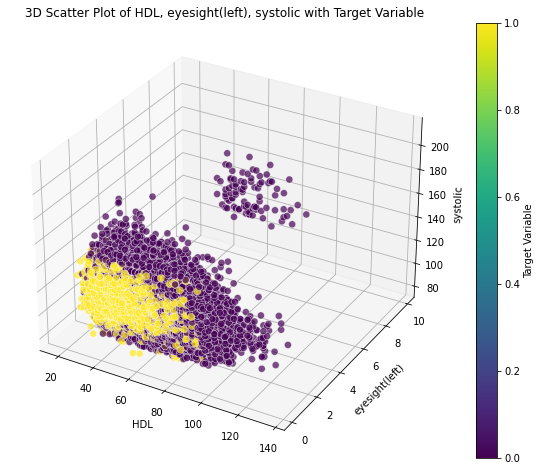

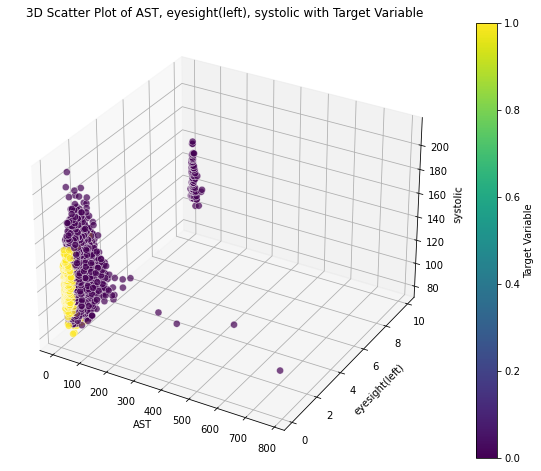

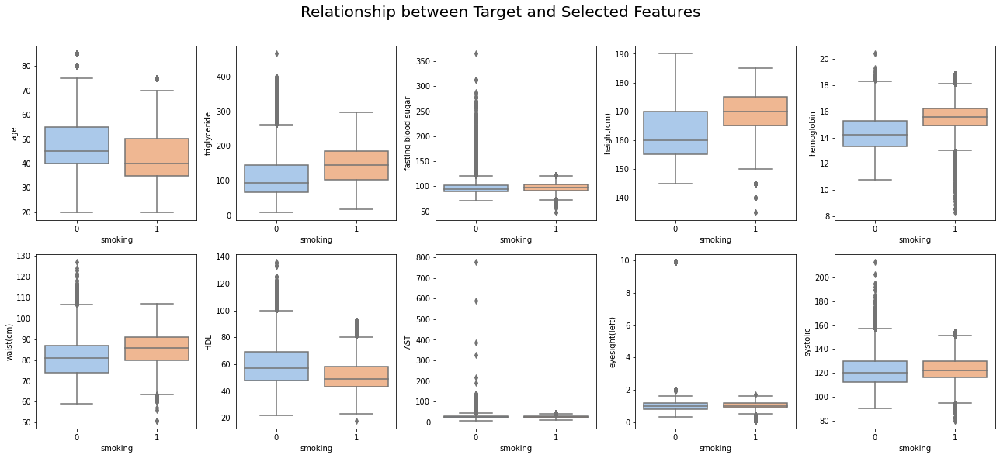

In [15]:
# 3D Scatter Plots 
feature_combinations = list(itertools.combinations(selected_columns[:-1], 3))

for combination in feature_combinations:
    fig = plt.figure(figsize=(12, 8))
    ax = fig.add_subplot(111, projection='3d')

    x, y, z = combination
    ax.scatter( data[x], data[y], data[z], 
                c=data[target_column],  # Color represents the target variable
                cmap='viridis',
                s=50,
                alpha=0.7,
                edgecolors='w',  # White edge color for better visibility
                linewidths=0.5)

    ax.set_xlabel(x)
    ax.set_ylabel(y)
    ax.set_zlabel(z)
    ax.set_title(f"3D Scatter Plot of {x}, {y}, {z} with Target Variable")
    
    # Create a colorbar to show the mapping between color and target variable
    color_bar = plt.colorbar(ax.scatter([], [], [], c=[], cmap='viridis'))
    color_bar.set_label('Target Variable')
    plt.show()


# Relationship between Target and Selected Features
fig, axes = plt.subplots(nrows=2, ncols=5, figsize=(18, 8))

for i, feature in enumerate(selected_columns[:-1]):
    sns.boxplot(x=data[target_column], y=data[feature], ax=axes[i // 5, i % 5])

fig.suptitle("Relationship between Target and Selected Features", y=1.02, fontsize=20)
plt.tight_layout()
plt.show()

# Identify Patterns and Insights:

### Observation 1: High correlation between Feature hemogloben and height(cm)

### Observation 2: Non-linear relationship between Feature waist and the Target variable

### Observation 3: Outliers in Feature eyeslight may need special attention

## Feature Preprocessing:

### Feature transformation

#### Apply Log to this skewed data (to enhance it)

In [20]:
# Apply log transformation to skewed features
for feature in skewed_features.index:
    data[feature] = np.log1p(data[feature])

### Feature Generation

#### Binning of most effective features in the label

In [24]:
# List of features to be binned
features_to_bin = ['hemoglobin', 'height(cm)', 'triglyceride', 'age', 'waist(cm)']

# Function to perform binning for a specific feature
def bin_feature(df, feature, num_bins=5):
    bins = pd.cut(df[feature], bins=num_bins, labels=False)
    df[feature + '_binned'] = bins.astype(str)
    return df

# Binning for each specified feature
for feature in features_to_bin:
    data = bin_feature(data, feature)

#### Create Interaction Terms between features

In [25]:
from sklearn.preprocessing import PolynomialFeatures
import pandas as pd

# Assuming 'data' is your DataFrame with features (X) and target variable 'smoking' (y)
# Replace 'data' with the actual name of your DataFrame if it's different

# Features with strong correlations
top_features = ['hemoglobin', 'height(cm)', 'triglyceride', 'waist(cm)']

# Extract top features and target variable
X_top = data[top_features]
y = data['smoking']

# Create interaction terms using PolynomialFeatures
poly = PolynomialFeatures(degree=2, interaction_only=True, include_bias=False)
X_interactions = pd.DataFrame(poly.fit_transform(X_top), columns=poly.get_feature_names_out(X_top.columns))

# Replace original features with interaction terms in the 'data' DataFrame
data = pd.concat([data, X_interactions], axis=1)

In [19]:
data.to_csv('data_done.csv', index=False)